## Unsupervised Learning - Association Rules

### Analyse the retail store data and help business understand customers buying pattern and also improve the sales by product placement.

Data: The transactions made by the customers in a retail store.
    
Description : A total of 557040 rows of transaction data.

In [1]:
# import libraries
import pandas as pd
import matplotlib
import matplotlib.pyplot as plt
from mlxtend.frequent_patterns import apriori, association_rules
from mlxtend.preprocessing import TransactionEncoder

In [2]:
import warnings
warnings.filterwarnings("ignore")

In [3]:
# import the data file
# Data is in list format and we use open function

retail_data = []
with open(r"D:\360digi\DS\Sharath\Association_Rules_2\handson\Association_Rules-Assignment_Datasets\transactions_retail.csv") as f:
    retail_data = f.read()
    
    
print(type(retail_data))
retail_data

<class 'str'>


'\'HANGING\',\'HEART\',\'HOLDER\',\'T-LIGHT\',\'WHITE\',NA\n\'LANTERN\',\'METAL\',\'WHITE\',NA,NA,NA\n\'COAT\',\'CREAM\',\'CUPID\',\'HANGER\',\'HEARTS\',NA\n\'BOTTLE\',\'FLAG\',\'HOT\',\'KNITTED\',\'UNION\',\'WATER\'\n\'HEART.\',\'HOTTIE\',\'RED\',\'WHITE\',\'WOOLLY\',NA\n\'7\',\'BABUSHKA\',\'BOXES\',\'NESTING\',\'SET\',NA\n\'FROSTED\',\'GLASS\',\'HOLDER\',\'STAR\',\'T-LIGHT\',NA\n\'HAND\',\'JACK\',\'UNION\',\'WARMER\',NA,NA\n\'DOT\',\'HAND\',\'POLKA\',\'RED\',\'WARMER\',NA\n\'ASSORTED\',\'BIRD\',\'COLOUR\',\'ORNAMENT\',NA,NA\n\'BEDROOM\',\'PLAYHOUSE\',\'POPPY\'\'S\',NA,NA,NA\n\'KITCHEN\',\'PLAYHOUSE\',\'POPPY\'\'S\',NA,NA,NA\n\'CHARLOTTE\',\'DOLL\',\'FELTCRAFT\',\'PRINCESS\',NA,NA\n\'COSY\',\'IVORY\',\'KNITTED\',\'MUG\',NA,NA\n\'6\',\'ASSORTED\',\'BOX\',\'COLOUR\',\'OF\',\'TEASPOONS\'\n\'BLOCKS\',\'BOX\',\'JIGSAW\',\'OF\',\'VINTAGE\',NA\n\'ALPHABET\',\'BLOCKS\',\'BOX\',\'OF\',\'VINTAGE\',NA\n\'BLOCK\',\'BUILDING\',\'HOME\',\'WORD\',NA,NA\n\'BLOCK\',\'BUILDING\',\'LOVE\',\'WORD\',NA,NA

In [4]:
#splitting the data into separate transaction using separator as "\n"
retail_data = retail_data.split("\n")
retail_data

["'HANGING','HEART','HOLDER','T-LIGHT','WHITE',NA",
 "'LANTERN','METAL','WHITE',NA,NA,NA",
 "'COAT','CREAM','CUPID','HANGER','HEARTS',NA",
 "'BOTTLE','FLAG','HOT','KNITTED','UNION','WATER'",
 "'HEART.','HOTTIE','RED','WHITE','WOOLLY',NA",
 "'7','BABUSHKA','BOXES','NESTING','SET',NA",
 "'FROSTED','GLASS','HOLDER','STAR','T-LIGHT',NA",
 "'HAND','JACK','UNION','WARMER',NA,NA",
 "'DOT','HAND','POLKA','RED','WARMER',NA",
 "'ASSORTED','BIRD','COLOUR','ORNAMENT',NA,NA",
 "'BEDROOM','PLAYHOUSE','POPPY''S',NA,NA,NA",
 "'KITCHEN','PLAYHOUSE','POPPY''S',NA,NA,NA",
 "'CHARLOTTE','DOLL','FELTCRAFT','PRINCESS',NA,NA",
 "'COSY','IVORY','KNITTED','MUG',NA,NA",
 "'6','ASSORTED','BOX','COLOUR','OF','TEASPOONS'",
 "'BLOCKS','BOX','JIGSAW','OF','VINTAGE',NA",
 "'ALPHABET','BLOCKS','BOX','OF','VINTAGE',NA",
 "'BLOCK','BUILDING','HOME','WORD',NA,NA",
 "'BLOCK','BUILDING','LOVE','WORD',NA,NA",
 "'BOX','HEART','METAL','RECIPE','WITH',NA",
 "'DOORMAT','ENGLAND','NEW',NA,NA,NA",
 "'JAM','JARS','MAKING','SET','W

In [5]:
# Remove the extra string characters and also 'NA' values
x = [[word.strip('\'') for word in line.split(',') if word != 'NA'] for line in retail_data]
x

[['HANGING', 'HEART', 'HOLDER', 'T-LIGHT', 'WHITE'],
 ['LANTERN', 'METAL', 'WHITE'],
 ['COAT', 'CREAM', 'CUPID', 'HANGER', 'HEARTS'],
 ['BOTTLE', 'FLAG', 'HOT', 'KNITTED', 'UNION', 'WATER'],
 ['HEART.', 'HOTTIE', 'RED', 'WHITE', 'WOOLLY'],
 ['7', 'BABUSHKA', 'BOXES', 'NESTING', 'SET'],
 ['FROSTED', 'GLASS', 'HOLDER', 'STAR', 'T-LIGHT'],
 ['HAND', 'JACK', 'UNION', 'WARMER'],
 ['DOT', 'HAND', 'POLKA', 'RED', 'WARMER'],
 ['ASSORTED', 'BIRD', 'COLOUR', 'ORNAMENT'],
 ['BEDROOM', 'PLAYHOUSE', "POPPY''S"],
 ['KITCHEN', 'PLAYHOUSE', "POPPY''S"],
 ['CHARLOTTE', 'DOLL', 'FELTCRAFT', 'PRINCESS'],
 ['COSY', 'IVORY', 'KNITTED', 'MUG'],
 ['6', 'ASSORTED', 'BOX', 'COLOUR', 'OF', 'TEASPOONS'],
 ['BLOCKS', 'BOX', 'JIGSAW', 'OF', 'VINTAGE'],
 ['ALPHABET', 'BLOCKS', 'BOX', 'OF', 'VINTAGE'],
 ['BLOCK', 'BUILDING', 'HOME', 'WORD'],
 ['BLOCK', 'BUILDING', 'LOVE', 'WORD'],
 ['BOX', 'HEART', 'METAL', 'RECIPE', 'WITH'],
 ['DOORMAT', 'ENGLAND', 'NEW'],
 ['JAM', 'JARS', 'MAKING', 'SET', 'WITH'],
 ['COAT', 'FASHI

In [6]:
# Discarding data with character length 2 which was not giving meaning to our analysis. 
x = [[word for word in line if len(word) > 3 ] for line in x]
x

[['HANGING', 'HEART', 'HOLDER', 'T-LIGHT', 'WHITE'],
 ['LANTERN', 'METAL', 'WHITE'],
 ['COAT', 'CREAM', 'CUPID', 'HANGER', 'HEARTS'],
 ['BOTTLE', 'FLAG', 'KNITTED', 'UNION', 'WATER'],
 ['HEART.', 'HOTTIE', 'WHITE', 'WOOLLY'],
 ['BABUSHKA', 'BOXES', 'NESTING'],
 ['FROSTED', 'GLASS', 'HOLDER', 'STAR', 'T-LIGHT'],
 ['HAND', 'JACK', 'UNION', 'WARMER'],
 ['HAND', 'POLKA', 'WARMER'],
 ['ASSORTED', 'BIRD', 'COLOUR', 'ORNAMENT'],
 ['BEDROOM', 'PLAYHOUSE', "POPPY''S"],
 ['KITCHEN', 'PLAYHOUSE', "POPPY''S"],
 ['CHARLOTTE', 'DOLL', 'FELTCRAFT', 'PRINCESS'],
 ['COSY', 'IVORY', 'KNITTED'],
 ['ASSORTED', 'COLOUR', 'TEASPOONS'],
 ['BLOCKS', 'JIGSAW', 'VINTAGE'],
 ['ALPHABET', 'BLOCKS', 'VINTAGE'],
 ['BLOCK', 'BUILDING', 'HOME', 'WORD'],
 ['BLOCK', 'BUILDING', 'LOVE', 'WORD'],
 ['HEART', 'METAL', 'RECIPE', 'WITH'],
 ['DOORMAT', 'ENGLAND'],
 ['JARS', 'MAKING', 'WITH'],
 ['COAT', 'FASHION', 'PARIS', 'RACK'],
 ['COAT', 'FASHION', 'PARIS', 'RACK', 'YELLOW'],
 ['BLUE', 'COAT', 'FASHION', 'PARIS', 'RACK'],


In [7]:
# TransactionEncoder: Encoder for transaction data in Python lists
# Encodes transaction data in form of a Python list of lists into a NumPy array

TE = TransactionEncoder()
X_1hot = TE.fit(x).transform(x)
X_1hot

array([[False, False, False, ..., False, False, False],
       [False, False, False, ..., False, False, False],
       [False, False, False, ..., False, False, False],
       ...,
       [False, False, False, ..., False, False, False],
       [False, False, False, ..., False, False, False],
       [False, False, False, ..., False, False, False]])

In [8]:
retail_df = pd.DataFrame(X_1hot, columns = TE.columns_)
retail_df

,"""'25W","""'ANGEL","""'ART","""'ASHTRAY","""'BIN","""'BOX","""'BUTTERFLIES","""'CABINET","""'CAKESTAND","""'CARD",...,unsaleable.,w/hse,water,website,wet/rusty,wet?,with,wrong,wrongly,zero
0,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
1,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
2,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
3,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
4,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
557037,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
557038,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
557039,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
557040,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False


In [9]:
retail_df.shape

(557042, 2317)

In [10]:
## Elementary Analysis ##
# Most popular items
count = retail_df.loc[:,:].sum()
print(count)

"'25W         2
"'ANGEL       2
"'ART         1
"'ASHTRAY     4
"'BIN         2
             ..
wet?          1
with          2
wrong         5
wrongly      13
zero          1
Length: 2317, dtype: int64


In [11]:
popular_item = count.sort_values(0, ascending = False).head(10)
popular_item

HEART        38714
RETROSPOT    35126
VINTAGE      33748
DESIGN       30066
PINK         29526
CHRISTMAS    25131
CAKE         21461
JUMBO        21139
METAL        20842
WHITE        20813
dtype: int64

In [12]:
popular_item = popular_item.to_frame()
popular_item

,0
HEART,38714
RETROSPOT,35126
VINTAGE,33748
DESIGN,30066
PINK,29526
CHRISTMAS,25131
CAKE,21461
JUMBO,21139
METAL,20842
WHITE,20813


In [13]:
popular_item = popular_item.reset_index()
popular_item

,index,0
0,HEART,38714
1,RETROSPOT,35126
2,VINTAGE,33748
3,DESIGN,30066
4,PINK,29526
5,CHRISTMAS,25131
6,CAKE,21461
7,JUMBO,21139
8,METAL,20842
9,WHITE,20813


In [14]:
popular_item = popular_item.rename(columns = {"index": "items", 0: "count"})
popular_item

,items,count
0,HEART,38714
1,RETROSPOT,35126
2,VINTAGE,33748
3,DESIGN,30066
4,PINK,29526
5,CHRISTMAS,25131
6,CAKE,21461
7,JUMBO,21139
8,METAL,20842
9,WHITE,20813


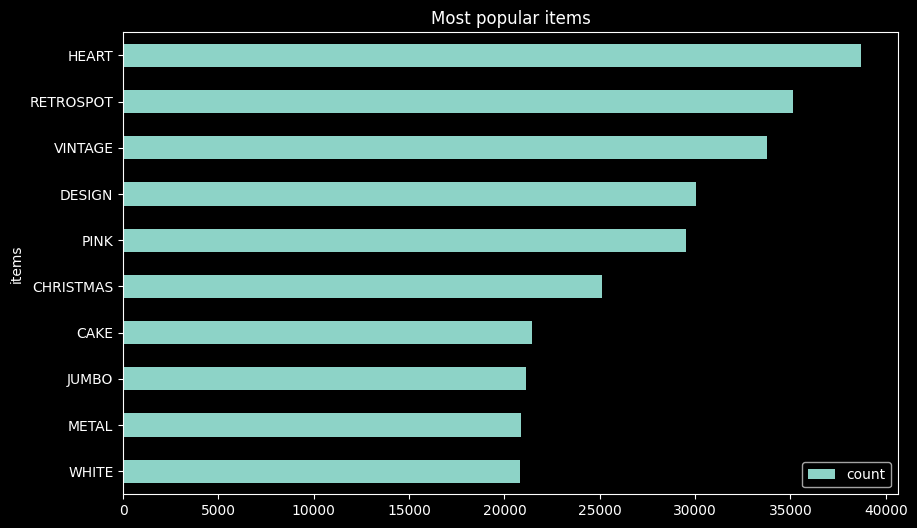

In [15]:
# Data visulaization
%matplotlib inline
plt.rcParams['figure.figsize'] = (10,6)
matplotlib.style.use('dark_background')
ax= popular_item.plot.barh(x = 'items', y = 'count')
plt.title('Most popular items')
plt.gca().invert_yaxis()

In [ ]:
# Customers most preferred item is anything of 'HEART' or a bundled product and also 'RETROSPOT'.
# The least popular item is 'WHITE'. 

### Apriori Algorithm

In [16]:
# Itemsets
freq_itemsets = apriori(retail_df, min_support = 0.005, max_len = 4, use_colnames = True)
freq_itemsets

,support,itemsets
0,0.008498,(50''S)
1,0.008170,(ALARM)
2,0.007039,(ALPHABET)
3,0.011629,(ANTIQUE)
4,0.007177,(APPLES)
...,...,...
230,0.011482,"(HOLDER, HANGING, T-LIGHT)"
231,0.010441,"(HOLDER, HEART, T-LIGHT)"
232,0.005479,"(SAUCER, TEACUP, REGENCY)"
233,0.005118,"(METAL, FRENCH, BLUE, SIGN)"


In [17]:
# Most frequent itemsets based on support
freq_itemsets.sort_values('support', ascending = False, inplace = True)
freq_itemsets

,support,itemsets
67,0.069499,(HEART)
108,0.063058,(RETROSPOT)
144,0.060584,(VINTAGE)
42,0.053974,(DESIGN)
101,0.053005,(PINK)
...,...,...
163,0.005118,"(METAL, BLUE)"
164,0.005118,"(SIGN, BLUE)"
187,0.005118,"(WHITE, FINISH)"
162,0.005118,"(FRENCH, BLUE)"


In [18]:
# Association Rules
rules = association_rules(freq_itemsets, metric = "lift", min_threshold = 1)
rules.head(20)

,antecedents,consequents,antecedent support,consequent support,support,confidence,lift,leverage,conviction
0,(METAL),(SIGN),0.037415,0.030515,0.027169,0.726130,23.796027,0.026027,3.539946
1,(SIGN),(METAL),0.030515,0.037415,0.027169,0.890340,23.796027,0.026027,8.777903
2,(HOLDER),(T-LIGHT),0.029192,0.026136,0.019914,0.682184,26.101061,0.019151,3.064241
3,(T-LIGHT),(HOLDER),0.026136,0.029192,0.019914,0.761934,26.101061,0.019151,4.077899
4,(CASES),(CAKE),0.021567,0.038527,0.017507,0.811720,21.069006,0.016676,5.106605
5,(CAKE),(CASES),0.038527,0.021567,0.017507,0.454406,21.069006,0.016676,1.793333
6,(WATER),(BOTTLE),0.017907,0.020998,0.015374,0.858546,40.886243,0.014998,6.921007
7,(BOTTLE),(WATER),0.020998,0.017907,0.015374,0.732154,40.886243,0.014998,3.666626
8,(HEART),(HANGING),0.069499,0.030585,0.013629,0.196105,6.411844,0.011504,1.205897
9,(HANGING),(HEART),0.030585,0.069499,0.013629,0.445618,6.411844,0.011504,1.678448


In [19]:
rules.sort_values('lift', ascending = False).head(20)

,antecedents,consequents,antecedent support,consequent support,support,confidence,lift,leverage,conviction
196,"(FRENCH, SIGN)","(METAL, BLUE)",0.005118,0.005118,0.005118,1.000000,195.384777,0.005092,inf
193,"(METAL, BLUE)","(FRENCH, SIGN)",0.005118,0.005118,0.005118,1.000000,195.384777,0.005092,inf
149,"(SAUCER, REGENCY)",(TEACUP),0.005479,0.005479,0.005479,1.000000,182.517038,0.005449,inf
152,(TEACUP),"(SAUCER, REGENCY)",0.005479,0.005479,0.005479,1.000000,182.517038,0.005449,inf
146,(RIBBON),(REEL),0.005579,0.005581,0.005578,0.999678,179.113146,0.005547,3090.653423
147,(REEL),(RIBBON),0.005581,0.005579,0.005578,0.999357,179.113146,0.005547,1545.826711
137,(WALLET),"(CARD, TRAVEL)",0.005655,0.005655,0.005655,1.000000,176.838730,0.005623,inf
136,"(CARD, TRAVEL)",(WALLET),0.005655,0.005655,0.005655,1.000000,176.838730,0.005623,inf
192,"(METAL, FRENCH)","(SIGN, BLUE)",0.006026,0.005118,0.005118,0.849270,165.934465,0.005087,6.600432
197,"(SIGN, BLUE)","(METAL, FRENCH)",0.005118,0.006026,0.005118,1.000000,165.934465,0.005087,inf


### Handling Profusion of Rules (Duplication elimination)

In [20]:
def to_list(i):
    return (sorted(list(i)))

In [21]:
ma_X = rules.antecedents.apply(to_list) + rules.consequents.apply(to_list)
ma_X

0          [METAL, SIGN]
1          [SIGN, METAL]
2      [HOLDER, T-LIGHT]
3      [T-LIGHT, HOLDER]
4          [CASES, CAKE]
             ...        
227      [FINISH, WHITE]
228       [FRENCH, BLUE]
229       [BLUE, FRENCH]
230      [LARGE, WICKER]
231      [WICKER, LARGE]
Length: 232, dtype: object

In [22]:
ma_X = ma_X.apply(sorted)
ma_X

0          [METAL, SIGN]
1          [METAL, SIGN]
2      [HOLDER, T-LIGHT]
3      [HOLDER, T-LIGHT]
4          [CAKE, CASES]
             ...        
227      [FINISH, WHITE]
228       [BLUE, FRENCH]
229       [BLUE, FRENCH]
230      [LARGE, WICKER]
231      [LARGE, WICKER]
Length: 232, dtype: object

In [23]:
rules_sets = list(ma_X)
rules_sets

[['METAL', 'SIGN'],
 ['METAL', 'SIGN'],
 ['HOLDER', 'T-LIGHT'],
 ['HOLDER', 'T-LIGHT'],
 ['CAKE', 'CASES'],
 ['CAKE', 'CASES'],
 ['BOTTLE', 'WATER'],
 ['BOTTLE', 'WATER'],
 ['HANGING', 'HEART'],
 ['HANGING', 'HEART'],
 ['HANGING', 'T-LIGHT'],
 ['HANGING', 'T-LIGHT'],
 ['DOLLY', 'GIRL'],
 ['DOLLY', 'GIRL'],
 ['HEART', 'HOLDER'],
 ['HEART', 'HOLDER'],
 ['HANGING', 'HOLDER'],
 ['HANGING', 'HOLDER'],
 ['PINK', 'POLKADOT'],
 ['PINK', 'POLKADOT'],
 ['HANGING', 'HOLDER', 'T-LIGHT'],
 ['HANGING', 'HOLDER', 'T-LIGHT'],
 ['HANGING', 'HOLDER', 'T-LIGHT'],
 ['HANGING', 'HOLDER', 'T-LIGHT'],
 ['HANGING', 'HOLDER', 'T-LIGHT'],
 ['HANGING', 'HOLDER', 'T-LIGHT'],
 ['CHRISTMAS', 'VINTAGE'],
 ['CHRISTMAS', 'VINTAGE'],
 ['HEART', 'HOLDER', 'T-LIGHT'],
 ['HEART', 'HOLDER', 'T-LIGHT'],
 ['HEART', 'HOLDER', 'T-LIGHT'],
 ['HEART', 'HOLDER', 'T-LIGHT'],
 ['HEART', 'HOLDER', 'T-LIGHT'],
 ['HEART', 'HOLDER', 'T-LIGHT'],
 ['HEART', 'T-LIGHT'],
 ['HEART', 'T-LIGHT'],
 ['DESIGN', 'LUNCH'],
 ['DESIGN', 'LUNCH'],
 [

In [24]:
unique_rules_sets = [list(m) for m in set(tuple(i) for i in rules_sets)]
unique_rules_sets

[['HANGING', 'HEART', 'HOLDER', 'T-LIGHT'],
 ['HANGING', 'HOLDER'],
 ['HOLDER', 'T-LIGHT'],
 ['BLUE', 'METAL', 'SIGN'],
 ['DESIGN', 'SPACEBOY'],
 ['HANGING', 'HEART', 'HOLDER'],
 ['FRENCH', 'METAL', 'SIGN'],
 ['GLASS', 'T-LIGHT'],
 ['DOLLY', 'GIRL'],
 ['PENCILS', 'TUBE'],
 ['METAL', 'SIGN'],
 ['JACK', 'UNION'],
 ['BAKELIKE', 'CLOCK'],
 ['CAKE', 'PACK'],
 ['ALARM', 'BAKELIKE'],
 ['JUMBO', 'VINTAGE'],
 ['CHAIN', 'PAPER'],
 ['CAKE', 'CASES', 'PACK'],
 ['HANGING', 'T-LIGHT'],
 ['PAISLEY', 'VINTAGE'],
 ['BLUE', 'FRENCH', 'METAL', 'SIGN'],
 ['HEART', 'WHITE'],
 ['PAPER', 'RETROSPOT'],
 ['BLUE', 'METAL'],
 ['REEL', 'RIBBON'],
 ['DECORATION', 'HANGING'],
 ['DESIGN', 'LUNCH'],
 ['DESIGN', 'PANTRY'],
 ['HEART', 'HOLDER'],
 ['LONDON', 'LOVE'],
 ['CERAMIC', 'KNOB'],
 ['FRENCH', 'SIGN'],
 ['BLUE', 'FRENCH', 'SIGN'],
 ['HEART', 'T-LIGHT'],
 ['CERAMIC', 'DRAWER'],
 ['BLUE', 'FRENCH'],
 ['HANGING', 'HEART', 'T-LIGHT'],
 ['CARD', 'WALLET'],
 ['CALM', 'KEEP'],
 ['REGENCY', 'SAUCER', 'TEACUP'],
 ['DRAWER

In [25]:
index_rules = []

for i in unique_rules_sets:
    index_rules.append(rules_sets.index(i))
    
index_rules

[62,
 16,
 2,
 210,
 164,
 48,
 182,
 108,
 12,
 168,
 0,
 110,
 90,
 78,
 98,
 88,
 126,
 80,
 10,
 102,
 188,
 42,
 170,
 222,
 146,
 130,
 36,
 38,
 14,
 120,
 180,
 208,
 216,
 34,
 178,
 228,
 56,
 144,
 118,
 148,
 46,
 134,
 132,
 20,
 142,
 100,
 4,
 8,
 162,
 44,
 156,
 166,
 112,
 122,
 116,
 76,
 26,
 226,
 104,
 128,
 92,
 54,
 154,
 28,
 86,
 124,
 106,
 158,
 140,
 172,
 202,
 18,
 114,
 160,
 224,
 230,
 40,
 6]

In [26]:
# Rules without any redundancy 
rules_no_redundancy = rules.iloc[index_rules, :]
rules_no_redundancy

,antecedents,consequents,antecedent support,consequent support,support,confidence,lift,leverage,conviction
62,"(HOLDER, HANGING, HEART)",(T-LIGHT),0.008500,0.026136,0.008274,0.973390,37.242868,0.008052,36.597181
16,(HOLDER),(HANGING),0.029192,0.030585,0.011800,0.404219,13.216340,0.010907,1.627133
2,(HOLDER),(T-LIGHT),0.029192,0.026136,0.019914,0.682184,26.101061,0.019151,3.064241
210,"(METAL, SIGN)",(BLUE),0.027169,0.034676,0.005118,0.188384,5.432681,0.004176,1.189385
164,(DESIGN),(SPACEBOY),0.053974,0.019444,0.005418,0.100379,5.162535,0.004368,1.089966
...,...,...,...,...,...,...,...,...,...
160,(CAKE),(DESIGN),0.038527,0.053974,0.005479,0.142211,2.634795,0.003399,1.102866
224,(SIGN),(BLUE),0.030515,0.034676,0.005118,0.167726,4.836934,0.004060,1.159863
230,(LARGE),(WICKER),0.017589,0.012820,0.005091,0.289447,22.578636,0.004866,1.389313
40,(DECORATION),(HEART),0.023303,0.069499,0.009303,0.399199,5.743930,0.007683,1.548767


In [27]:
# Sorted list and top 10 rules 
rules10 = rules_no_redundancy.sort_values('lift', ascending = False).head(10)

rules10

,antecedents,consequents,antecedent support,consequent support,support,confidence,lift,leverage,conviction
146,(RIBBON),(REEL),0.005579,0.005581,0.005578,0.999678,179.113146,0.005547,3090.653423
154,(SAUCER),(TEACUP),0.006084,0.005479,0.005479,0.900561,164.367660,0.005446,10.001282
118,(KEEP),(CALM),0.006500,0.006355,0.006355,0.977630,153.836509,0.006314,44.419612
140,(WALLET),(TRAVEL),0.005655,0.007477,0.005655,1.000000,133.743577,0.005613,inf
134,"(WALLET, CARD)",(TRAVEL),0.005655,0.007477,0.005655,1.000000,133.743577,0.005613,inf
98,(ALARM),(BAKELIKE),0.008170,0.008008,0.008008,0.980224,122.399912,0.007943,50.161710
110,(JACK),(UNION),0.006850,0.009811,0.006850,1.000000,101.929003,0.006783,inf
106,(SWEET),(HOME),0.007315,0.009994,0.007134,0.975215,97.581383,0.007061,39.943317
114,(WARMER),(HAND),0.008297,0.008875,0.006639,0.800087,90.145997,0.006565,4.957768
46,(DRAWER),(KNOB),0.011522,0.008892,0.008892,0.771736,86.793705,0.008789,4.341934


In [28]:
rules_no_redundancy.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 78 entries, 62 to 6
Data columns (total 9 columns):
 #   Column              Non-Null Count  Dtype  
---  ------              --------------  -----  
 0   antecedents         78 non-null     object 
 1   consequents         78 non-null     object 
 2   antecedent support  78 non-null     float64
 3   consequent support  78 non-null     float64
 4   support             78 non-null     float64
 5   confidence          78 non-null     float64
 6   lift                78 non-null     float64
 7   leverage            78 non-null     float64
 8   conviction          78 non-null     float64
dtypes: float64(7), object(2)
memory usage: 6.1+ KB


<AxesSubplot:xlabel='support', ylabel='confidence'>

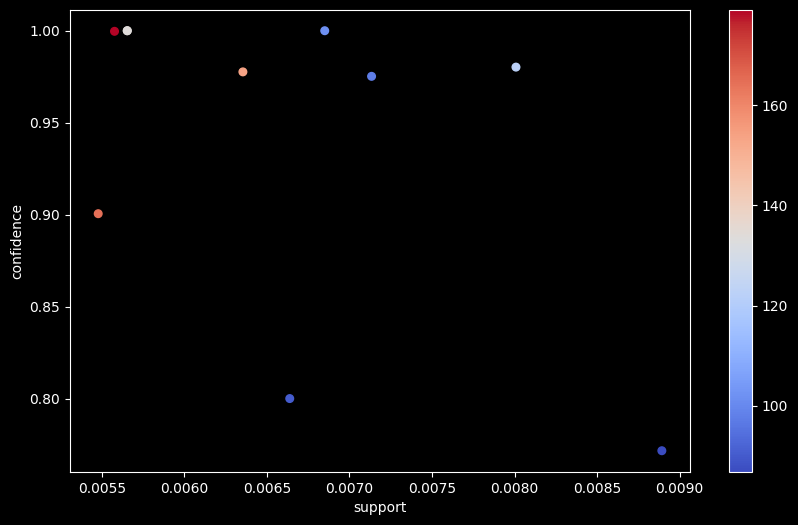

In [29]:
rules10.plot(x = "support", y = "confidence", c = rules10.lift, kind="scatter", s = 30, cmap = plt.cm.coolwarm)

In [ ]:
# Based on the association rules generated. 
# Placing REGENCY, SAUCER next to TEACUP and CARD, TRAVEL next to WALLET and CLOCK, BAKELIKE next to ALARM will help in increase of sales.
